# Case Study

As mentioned before, we will test kringing using observation of poor air quality due to wildfire smoke. We chose July 16, 2021, as there was a high concentration of smoke across a large portion of North America. 

Load python modules

In [1]:
import context
import numpy as np
import pandas as pd
import xarray as xr
import geopandas as gpd

import plotly.express as px
import matplotlib.image as mpimg
import plotly.figure_factory as ff

from context import data_dir

******************************
context imported. Front of path:
/Users/rodell/krige-smoke
/Users/rodell/krige-smoke/docs/source
******************************

through /Users/rodell/krige-smoke/docs/source/context.py -- pha


Satellite observations of wildfire smoke in the visible spectrum on July 16, 2021. 
- Also shown are the satellite hotspot detects (ie wildfire) in orange.


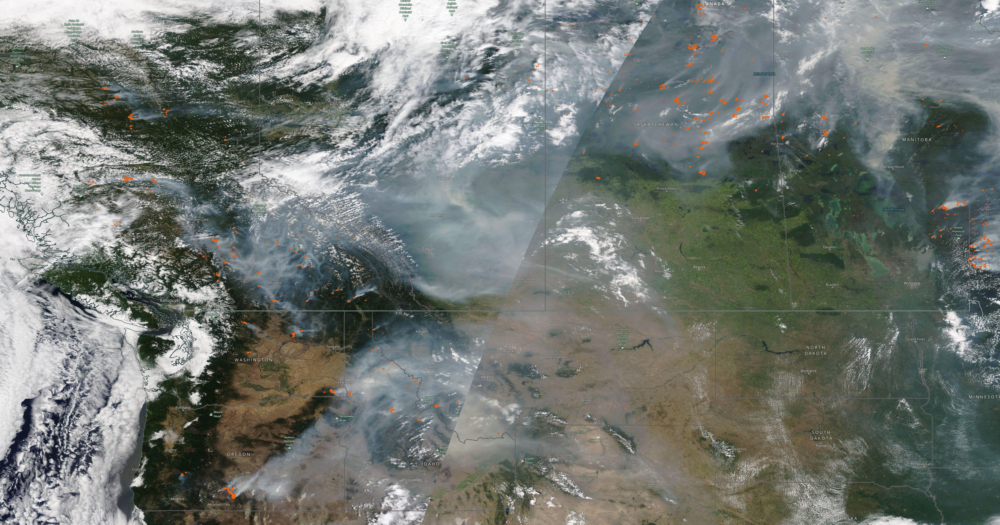

In [2]:
img = mpimg.imread(str(data_dir) + "/obs/worldview.jpeg")
fig = px.imshow(img)
fig.update_layout(margin=dict(l=10, r=10, t=30, b=30))
fig.show()

## Data Setup

### Air quality monitors
- See [find-pa-station.py](https://github.com/cerodell/krige-smoke/blob/main/scripts/find-pa-sations.py),
 [get-pa-data.py](https://github.com/cerodell/krige-smoke/blob/main/scripts/get-pa-data.py)
 and [reformate-gov.py](https://github.com/cerodell/krige-smoke/blob/main/scripts/reformate-gov.py) for how I obtained and combined data in a single dataset.

### Datetime and domain 
Here we define a datetime and domain of interest to test kriging. 

In [3]:
## Define domain and datetime of interest
wesn = [-129.0, -90.0, 40.0, 60.0]
dot = "2021-07-16T22:00:00"


## Open Government AQ data and index on dot
gov_ds = xr.open_dataset(str(data_dir) + f"/gov_aq.nc")
gov_ds = gov_ds.sel(datetime=dot)

## Open PurpleAir AQ data, index on dot and drop variables to make ds concat with gov_ds
pa_ds = xr.open_dataset(str(data_dir) + f"/purpleair_north_america.nc")
pa_ds = pa_ds.sel(datetime=dot)
pa_ds = pa_ds.drop(["PM1.0", "PM10.0", "pressure", "PM2.5_ATM"])

## concat both datasets on as station id
ds = xr.concat([pa_ds, gov_ds], dim="id")

### Clean Data 
Remove outliers by:

- Erroneously high values

- Non-physical negative values

- Outside two standard deviation

In [4]:
ds = ds.where(ds["PM2.5"] < 1000, drop=True)  ## Erroneously high values
ds = ds.where(ds["PM2.5"] > 0, drop=True)  ## Non-physical negative values
mean = ds["PM2.5"].mean()  ## outside two standard deviation
sd = ds["PM2.5"].std()
sd_ds = ds.where(
    (ds["PM2.5"] > mean - 2 * sd) & (ds["PM2.5"] < mean + 2 * sd), drop=True
)

sd_ds

<xarray.Dataset>
Dimensions:   (id: 8798)
Coordinates:
    datetime  datetime64[ns] 2021-07-16T22:00:00
  * id        (id) object 14633 14091 42073 53069 ... 'us_31' 'us_32' 'us_34'
    lat       (id) float64 37.28 37.88 47.19 47.19 ... 45.7 45.91 46.36 46.72
    lon       (id) float64 -122.0 -122.1 -122.2 -122.2 ... -71.95 -72.51 -79.1
Data variables:
    PM2.5     (id) float32 6.454 6.682 0.862 1.078 ... 8.047 16.26 14.83 10.45

### Reformat Date
- Convert our dataset to a dataframe and drop all aq stations outside our domain of interest

In [5]:
df_pm25 = sd_ds["PM2.5"].to_dataframe().reset_index()
df_pm25 = df_pm25.loc[
    (df_pm25["lat"] > wesn[2])
    & (df_pm25["lat"] < wesn[3])
    & (df_pm25["lon"] > wesn[0])
    & (df_pm25["lon"] < wesn[1])
]

print(f"Number of AQ Monitors: {len(df_pm25)}")
df_pm25.head()

Number of AQ Monitors: 1839


,id,datetime,lat,lon,PM2.5
2,42073,2021-07-16 22:00:00,47.185173,-122.176855,0.862
3,53069,2021-07-16 22:00:00,47.190197,-122.177992,1.078
12,10808,2021-07-16 22:00:00,40.507316,-111.899188,9.780
16,85391,2021-07-16 22:00:00,48.454213,-123.283643,0.874
21,79095,2021-07-16 22:00:00,47.672130,-122.514183,0.784


### Plot Data
#### Distribution
Look at the data by plotting the measured PM 2.5 values distribution.

In [6]:
fig = ff.create_distplot([df_pm25["PM2.5"].values], ["PM2.5"], colors=["green"])
fig.show()

The data has 

#### Spatial scatter plot
Now,  look at the data by a scatter plot of the measured PM 2.5 values at each station.

In [7]:
fig = px.scatter_mapbox(
    df_pm25,
    lat="lat",
    lon="lon",
    color="PM2.5",
    size="PM2.5",
    color_continuous_scale="jet",
    # hover_name="id",
    center={"lat": 50.0, "lon": -110.0},
    hover_data=["PM2.5"],
    mapbox_style="carto-positron",
    zoom=3.0,
)
fig.update_layout(margin=dict(l=0, r=100, t=30, b=10))
fig.show()

We can see how the fires are creating poor air quality in the eastern Rockies and prairies/plains.

### Reproject Data

We want to convert the data to the linear, meter-based Lambert projection (EPSG:3347) recommended by Statistics Canada. This conversion is helpful as lat/lon coordinates are not as suitable for measuring distances which is vital for interpolating data.

In [8]:

gpm25 = gpd.GeoDataFrame(
    df_pm25,
    crs="EPSG:4326",
    geometry=gpd.points_from_xy(df_pm25["lon"], df_pm25["lat"]),
).to_crs("EPSG:3347")
gpm25["Easting"], gpm25["Northing"] = gpm25.geometry.x, gpm25.geometry.y
gpm25.head()

,id,datetime,lat,lon,PM2.5,geometry,Easting,Northing
2,42073,2021-07-16 22:00:00,47.185173,-122.176855,0.862,POINT (3972238.901 1767531.888),3.972239e+06,1.767532e+06
3,53069,2021-07-16 22:00:00,47.190197,-122.177992,1.078,POINT (3972419.863 1768071.699),3.972420e+06,1.768072e+06
12,10808,2021-07-16 22:00:00,40.507316,-111.899188,9.780,POINT (4460286.051 743178.640),4.460286e+06,7.431786e+05
16,85391,2021-07-16 22:00:00,48.454213,-123.283643,0.874,POINT (3964698.001 1931774.531),3.964698e+06,1.931775e+06
21,79095,2021-07-16 22:00:00,47.672130,-122.514183,0.784,POINT (3974631.739 1827689.201),3.974632e+06,1.827689e+06


### Onto Ordinary Kriging...